<a href="https://colab.research.google.com/github/marcelhas/akt3/blob/main/bosna_oder_kebap.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import os

import tensorflow as tf
import matplotlib.pylab as plt
import numpy as np
from tensorflow.keras.preprocessing.image import img_to_array, load_img

2023-12-04 16:46:34.027069: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-12-04 16:46:34.114275: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE3 SSE4.1 SSE4.2 AVX AVX2 AVX_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [5]:
IMG_HEIGHT, IMG_WIDTH = 224, 224
batch_size = 10

# dataset that lists all image files in the direct subfolders of example_training_data
image_files = tf.data.Dataset.list_files([f"./*/*{t}" for t in ["jpeg", "jpg", "png"]])


def load_and_preprocess_image(path):
    # Load the image
    image = tf.io.decode_image(
        tf.io.read_file(path),
        channels=3, dtype=tf.float32, expand_animations=False)
    image = tf.image.resize(image, size=[IMG_HEIGHT, IMG_WIDTH])

    # Random data augmentation
    image = tf.image.random_flip_left_right(image)
    image = tf.image.random_flip_up_down(image)
    # see here for more data augmentation option
    # https://www.tensorflow.org/api_docs/python/tf/image/

    return image

def extract_label_from_path(path):
    # Extract the first subfolder name as the label
    label = tf.strings.split(path, os.sep)[-2]
    print(label)
    return label_to_int(label)

label_to_int = tf.keras.layers.StringLookup(
    vocabulary=[b"kebap", b"bosna"],
    output_mode="one_hot",
    num_oov_indices=0)
training_data = image_files.map(lambda x: (load_and_preprocess_image(x), extract_label_from_path(x)))
training_data = training_data.batch(batch_size)

Tensor("strided_slice:0", shape=(), dtype=string)


In [ ]:
#for img, label in training_data.take(1):
#    for i in range(img.shape[0]):
#        plt.figure()
#        plt.title(str(label[i]))
#        plt.imshow(img[i, ...])

In [ ]:
base_model = tf.keras.applications.resnet_v2.ResNet50V2(
        include_top=False,
        pooling='max',
        input_shape=(IMG_HEIGHT, IMG_WIDTH, 3),
        weights='imagenet')

# model = tf.keras.Sequential([
#     base_model,
#     tf.keras.layers.Dense(512, 'relu'),
#     tf.keras.layers.Dense(256, 'relu'),
#     tf.keras.layers.Dense(2, 'softmax')
# ])
base_model.trainable = False

In [ ]:
data_augmentation = tf.keras.Sequential([
    tf.keras.layers.RandomFlip("horizontal"),
    tf.keras.layers.RandomRotation(0.1),
    tf.keras.layers.RandomZoom(0.1),
])

In [ ]:
data_preprocessing = tf.keras.Sequential([
    tf.keras.layers.Rescaling(1./255),
    tf.keras.layers.Resizing(IMG_HEIGHT, IMG_WIDTH),
])

In [ ]:
model = tf.keras.Sequential([
  data_preprocessing,
  data_augmentation,
  base_model,
  tf.keras.layers.Dense(512, 'relu'),
  tf.keras.layers.Dense(256, 'relu'),
  tf.keras.layers.Dense(2, 'softmax')
])

model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'], run_eagerly=True)

model.fit(training_data, epochs=10)
#model.summary();

Epoch 1/10


ValueError: ignored

/content/drive/MyDrive/bosna_kebap/test/kebap083.jpg
1/1 [==============================] - 2s 2s/step
[[1.000000e+00 3.157438e-08]]
/content/drive/MyDrive/bosna_kebap/test/kebap074.jpg
1/1 [==============================] - 1s 551ms/step
[[1.0000000e+00 6.7454453e-10]]
/content/drive/MyDrive/bosna_kebap/test/kebap079.jpg
1/1 [==============================] - 0s 332ms/step
[[1.000000e+00 4.136208e-10]]
/content/drive/MyDrive/bosna_kebap/test/kebap059.jpg
1/1 [==============================] - 0s 351ms/step
[[1.0000000e+00 1.2929923e-09]]
/content/drive/MyDrive/bosna_kebap/test/kebap007.jpg
1/1 [==============================] - 0s 332ms/step
[[1.0000000e+00 1.7639145e-11]]
/content/drive/MyDrive/bosna_kebap/test/kebap035.jpg
1/1 [==============================] - 0s 328ms/step
[[9.999943e-01 5.710728e-06]]
/content/drive/MyDrive/bosna_kebap/test/kebap069.jpg
1/1 [==============================] - 0s 348ms/step
[[9.9999964e-01 3.9822282e-07]]
/content/drive/MyDrive/bosna_kebap/test/keb

<ipython-input-11-2b9835efe87d>:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


1/1 [==============================] - 0s 335ms/step
[[9.999999e-01 8.100643e-08]]
/content/drive/MyDrive/bosna_kebap/test/kebap062.jpg
1/1 [==============================] - 0s 313ms/step
[[9.9999940e-01 5.8516815e-07]]
/content/drive/MyDrive/bosna_kebap/test/kebap005.jpg
1/1 [==============================] - 0s 331ms/step
[[9.9999976e-01 2.6188047e-07]]
/content/drive/MyDrive/bosna_kebap/test/kebap011.jpg
1/1 [==============================] - 0s 318ms/step
[[9.9980050e-01 1.9948666e-04]]
/content/drive/MyDrive/bosna_kebap/test/kebap086.jpg
1/1 [==============================] - 0s 332ms/step
[[9.9999928e-01 6.9783164e-07]]
/content/drive/MyDrive/bosna_kebap/test/kebap054.jpg
1/1 [==============================] - 0s 326ms/step
[[1.00000e+00 5.19218e-08]]
/content/drive/MyDrive/bosna_kebap/test/kebap032.jpg
1/1 [==============================] - 0s 332ms/step
[[9.9999964e-01 3.0890416e-07]]
/content/drive/MyDrive/bosna_kebap/test/kebap030.jpg
1/1 [==============================] - 1

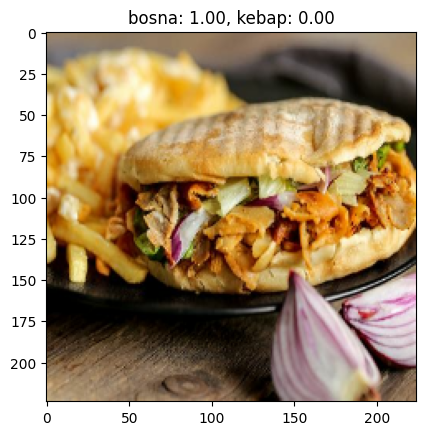

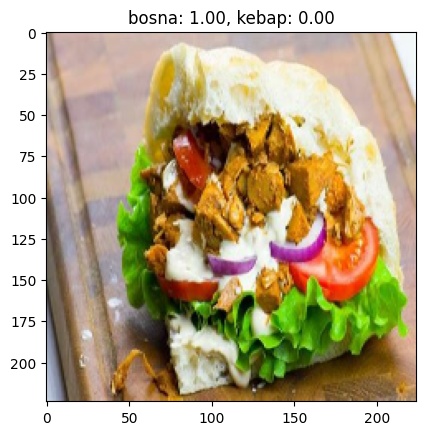

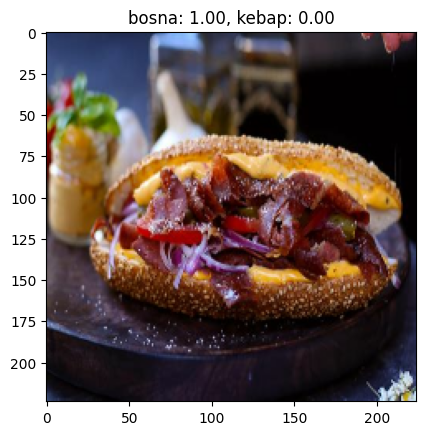

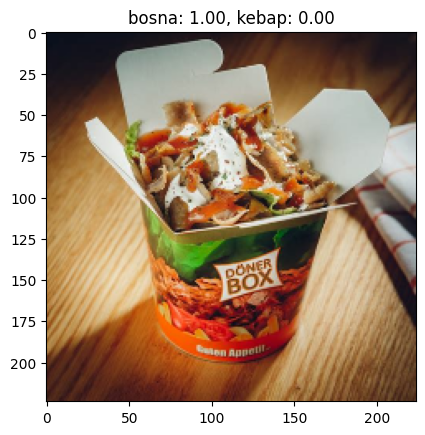

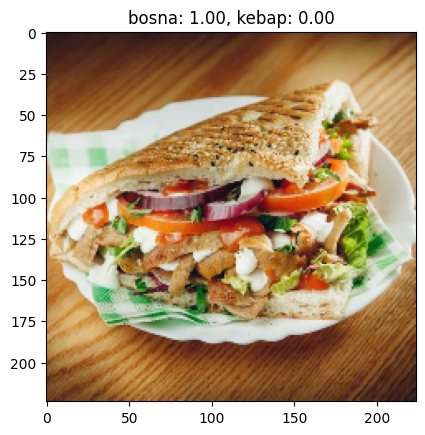

...

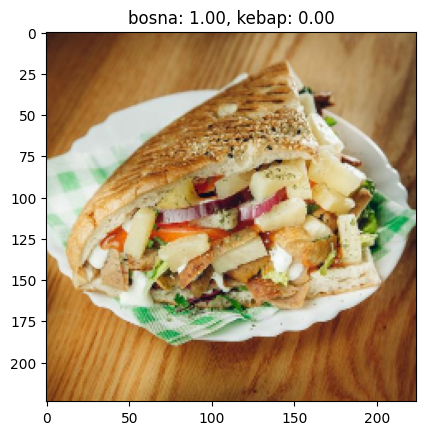

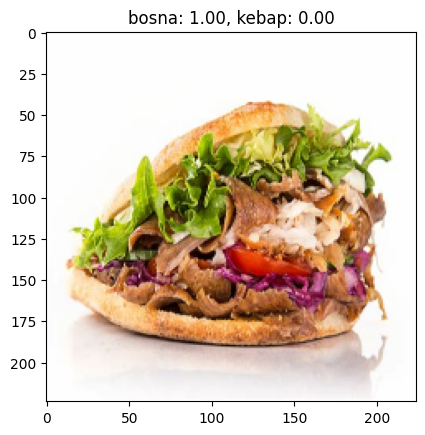

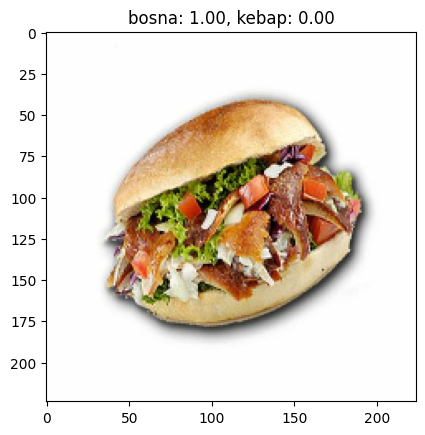

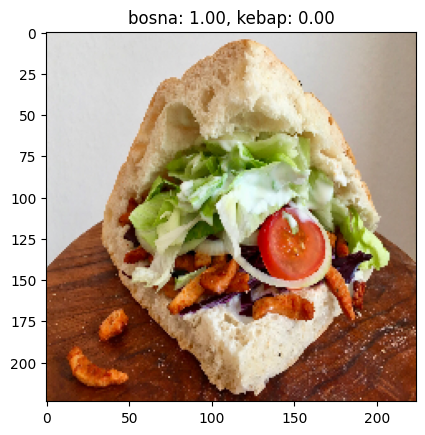

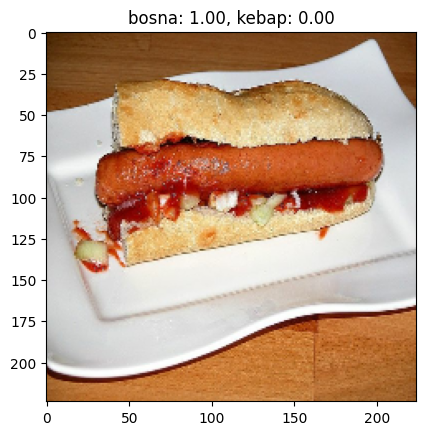

In [ ]:
folder_path = "/content/drive/MyDrive/bosna_kebap/test/"  # Replace with the path to your folder

# List all files in the folder
file_list = os.listdir(folder_path)

i = 0
for filename in file_list:
  #if i > 10:
    #break
  i = i+1
  file_path = os.path.join(folder_path, filename)
  if os.path.isfile(file_path):
    print(file_path)
    image = tf.io.decode_image(
            tf.io.read_file(file_path),
            channels=3, dtype=tf.float32, expand_animations=False)
    image = tf.image.resize(image, size=[IMG_HEIGHT, IMG_WIDTH])

    img = load_img(file_path, target_size=(IMG_WIDTH, IMG_HEIGHT))  # Resize the image to match your model's input size
    img = img_to_array(img)

    prediction = model.predict(tf.expand_dims(img, axis=0))
    print(prediction)
    plt.figure()
    bosna = "{:.2f}".format(prediction[0][0])
    kebap = "{:.2f}".format(prediction[0][1])
    plt.title(f"bosna: {bosna}, kebap: {kebap}")
    plt.imshow(image)

In [ ]:
from tensorflow.data import Dataset

def preprocess_image(image):
    # Resize the image to the desired dimensions
    image = tf.image.resize(image, [IMG_HEIGHT, IMG_WIDTH])
    # Normalize pixel values (if needed)
    # image = image / 255.0

    return image

def load_and_preprocess_image(image_path):
    # Load the image from file
    image = tf.io.read_file(image_path)
    # Decode the image and set its channels to 3 (for RGB images)
    image = tf.io.decode_image(image, channels=3, dtype=tf.float32, expand_animations=False)
    # Preprocess the image (e.g., resize, normalize, augment, etc.)
    image = preprocess_image(image)
    return image

test_image_directory = "/content/drive/MyDrive/bosna_kebap/test/"
file_paths = [os.path.join(test_image_directory, filename) for filename in os.listdir(test_image_directory)]


file_paths_dataset = tf.data.Dataset.from_tensor_slices(file_paths)
file_paths_dataset = file_paths_dataset.map(load_and_preprocess_image)
#for x in file_paths_dataset:
#  plt.imshow(x)


#model.predict(file_paths_dataset.batch(1))
